In [1]:
from xi_covutils import conservation
from Bio import AlignIO
import pandas as pd
import matplotlib.pyplot as plt
#from xi_covutils.conservation import BackgroundFreq, entropy

In [2]:
# Load regions datasets
regions = pd.read_csv('../datasets/regions.txt', sep= '\t')
cre = pd.read_csv('../datasets/cre.tsv', sep= '\t')

In [2]:
# seqs = []
# msa = open('../homology_transfer/pipeline_MSA_uniprot/A0A2I0BVG8_clustalO_full_gapstrip', 'r')
# lines = msa.readlines()
# for seq in lines:
#     seqs.append(seq)

In [14]:
# prueba
align = AlignIO.read(open('../homology_transfer/pipeline_MSA_uniprot/data_snake/09_align_selection_gstrip/A0A2I0BVG8_clustalO_full_gapstrip'), format = 'fasta')
ids = []
seqs_bio = []
for record in align:
    ids.append(record.id) # list with uniprot accessions
    seqs_bio.append(record.seq) # list with protein sequences

# change type from bio.seq to str
seqs =  [ str(seq) for seq in seqs_bio ]

In [16]:
# prueba
A0A2I0BVG8_full_unif = conservation.entropy(seq_data= seqs)#clustering_id=62
A0A2I0BVG8_full_62 = conservation.entropy(seq_data= seqs, clustering_id=62)#clustering_id=62

# regions
color regions in plots

In [41]:
regs = regions[regions.uniprot_acc == 'A0A2I0BVG8']
regs

,uniprot_acc,start,end,term_id
0,A0A2I0BVG8,56,325,kd1
286,A0A2I0BVG8,346,353,cre1


In [42]:
regs[regs.term_id.str.startswith("kd")]

,uniprot_acc,start,end,term_id
0,A0A2I0BVG8,56,325,kd1


In [44]:
if regs.shape[0] > 1:
    if regs.term_id.str.startswith("kd"):
        kd = regs[regs.term_id.str.startswith("kd")]
        kd = kd.reset_index()
        kd1 = kd.start[0], kd.end[0]
        if kd.shape[0] > 1: # puede haber 2 kds
            kd = kd.reset_index()
            kd1 = kd.start[0], kd.end[0]
            kd2 = kd.start[1], kd.end[1]
print(kd1, kd2)

ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

In [24]:
cis = cre[cre.uniprot_acc == 'A0A2I0BVG8']
cis

,uniprot_acc,start,end,term_id
0,A0A2I0BVG8,346,353,cre1


In [67]:
kd = regions[regions.uniprot_acc == 'A0A2I0BVG8']
kd = kd[kd.term_id.str.startswith("kd")]
kd

,uniprot_acc,start,end,term_id
0,A0A2I0BVG8,56,325,kd1


In [25]:
cis_range = range(cis.start.values[0], cis.end.values[0] + 1)
cis_range

range(346, 354)

In [26]:
for i,x in enumerate(A0A2I0BVG8_full_62):
    i += 1 # start in 1 (as sequences do)
    if i in cis_range:
        print(i)

346
347
348
349
350
351
352
353


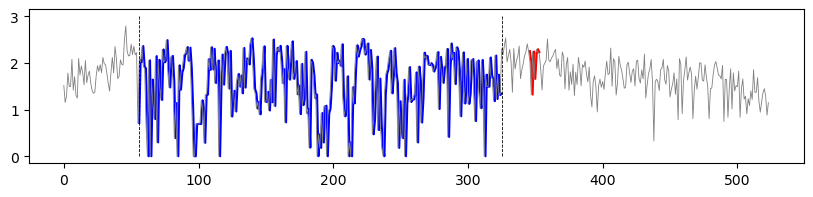

In [80]:
# plot CRE in a different color

plt.figure(figsize=(10,2))
#fig, ax = plt.subplots(ncols=1, nrows=2, sharex= True)

cis = cre[cre.uniprot_acc == 'A0A2I0BVG8']
cis_range = range(cis.start.values[0], cis.end.values[0]+1)
kd_range = range(kd.start.values[0], kd.end.values[0] + 1)

y_filt = []
y_kd = []
x_all = []
for i,x in enumerate(A0A2I0BVG8_full_62):
    i += 1 # start in 1 (as sequences do)
    x_all.append(x)
    if i in cis_range:
        y_filt.append(x)
    if i in kd_range:
        y_kd.append(x)




plt.plot(cis_range, y_filt, color= 'red')
plt.plot(kd_range, y_kd, color= 'blue')
plt.plot(x_all, color= 'gray', linewidth= 0.6)
plt.vlines(kd_range[0], -0, 3, linestyles ="dashed", colors= 'k', linewidth= 0.6)
plt.vlines(kd_range[-1], 0, 3, linestyles ="dashed", colors= 'k', linewidth= 0.6)
plt.show()

325

# compute conservation comparing Blosum62 vs Uniform

In [30]:
path = '../homology_transfer/pipeline_MSA_uniprot/data_snake/09_align_selection_gstrip'

/home/alvaro/miniconda3/envs/alvenv/lib/python3.7/site-packages/ipykernel_launcher.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


error in file Q7TNJ7_clustalO_full_gapstrip
error in file Q91VB2_clustalO_full_gapstrip
error in file Q96NX5_clustalO_full_gapstrip


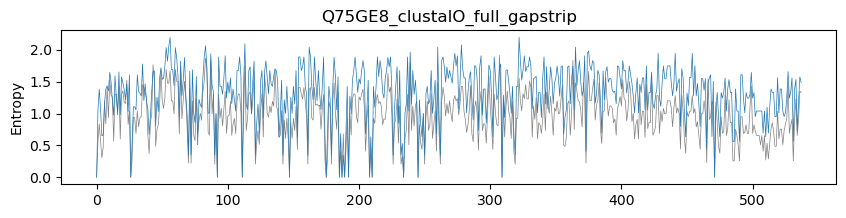

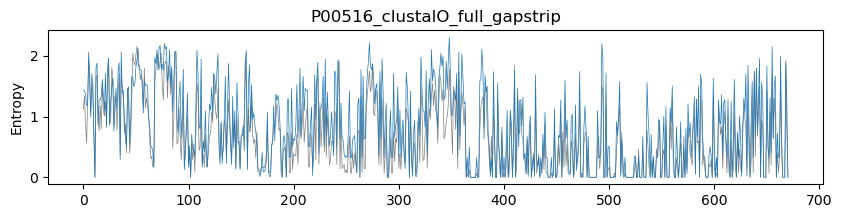

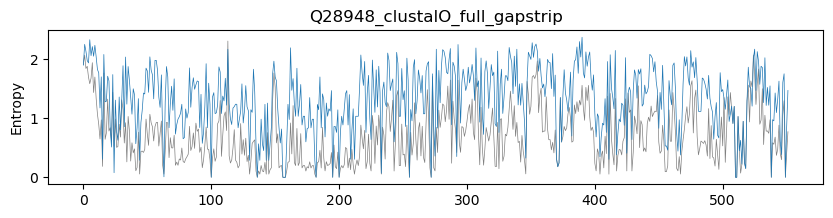

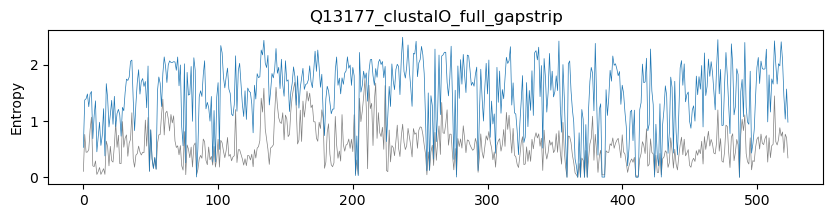

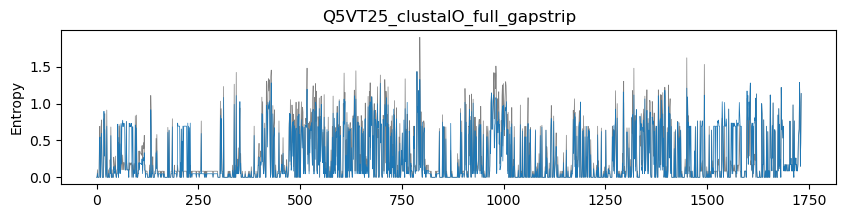

...

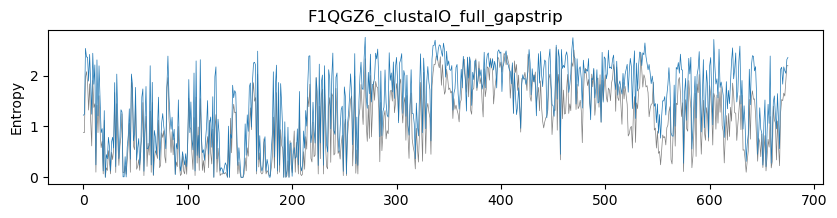

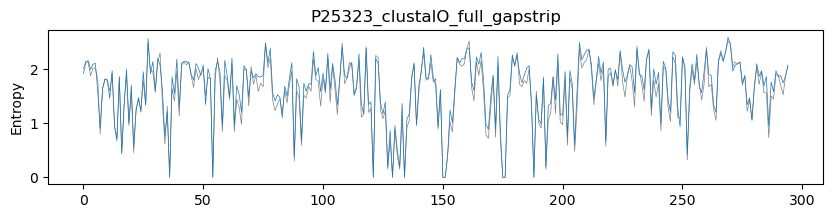

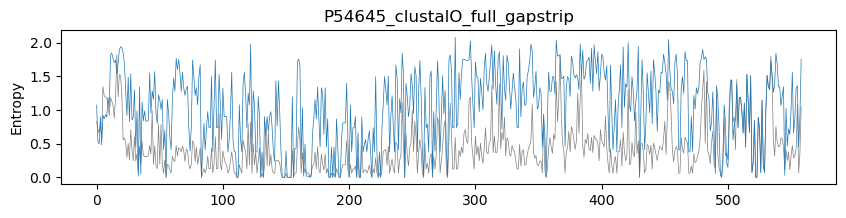

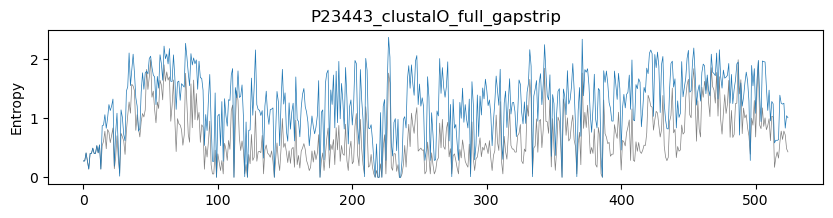

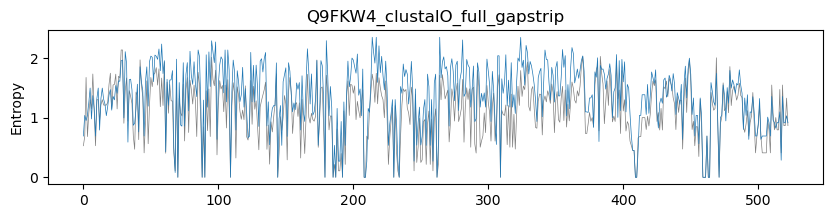

In [39]:
# First, iterate over the MSAs files
import os
# iterate over the MSA files
for filename in os.listdir(path):
    f = os.path.join(path, filename) # is the complete path to the msa file
    ids = []
    seqs_bio = []

    if os.path.isfile(f):
        try:
            # Get IDs and sequences from align object
            align = AlignIO.read(open(f), format = 'fasta')

            for record in align:
                ids.append(record.id) # list with uniprot accessions
                seqs_bio.append(record.seq) # list with protein sequences
            
            # change type from bio.seq to str
            seqs =  [ str(seq) for seq in seqs_bio ]
            
            # Calculate conservation (Uniform and Blosum62)
            conservation_unif = conservation.entropy(seq_data= seqs)
            conservation_62 = conservation.entropy(seq_data= seqs, clustering_id=62)
        except:
            print(f"error in file {filename}")

            
        plt.figure(figsize=(10,2))
        plt.plot(conservation_unif, color= 'gray', linewidth = 0.5)
        plt.plot(conservation_62, linewidth = 0.5)
        plt.title(filename)
        plt.ylabel("Entropy")
        #plt.legend()
        plt.savefig(f'../plots/msas_entropy/{filename}.png')